In [1]:
import torch
import torchvision
import numpy as np
import matplotlib.pyplot as plt
import torch.nn as nn
import matplotlib.pyplot as plt
import torchvision.utils as vutils
import torch.nn.functional as F
import os
from pathlib import Path
import json
# !pip install pytorch-fid
# !pip install torchinfo
from pytorch_fid import fid_score
from torchinfo import summary


In [2]:
transformer_CIFAR = torchvision.transforms.Compose([
    torchvision.transforms.Resize((64,64)),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize(mean=(0.5,0.5,0.5),std=(0.5,0.5,0.5))

])

In [3]:
train_dataset = torchvision.datasets.CIFAR10(root="../datasets", train=True, download=True, transform=transformer_CIFAR)
test_dataset = torchvision.datasets.CIFAR10(root="../datasets", train=False, download=True, transform=transformer_CIFAR)
train_data = torch.utils.data.DataLoader(train_dataset, batch_size=128, shuffle=True, num_workers=4)
test_data = torch.utils.data.DataLoader(test_dataset, batch_size=128, shuffle=True, num_workers=4)

In [4]:
classes_list = train_dataset.classes

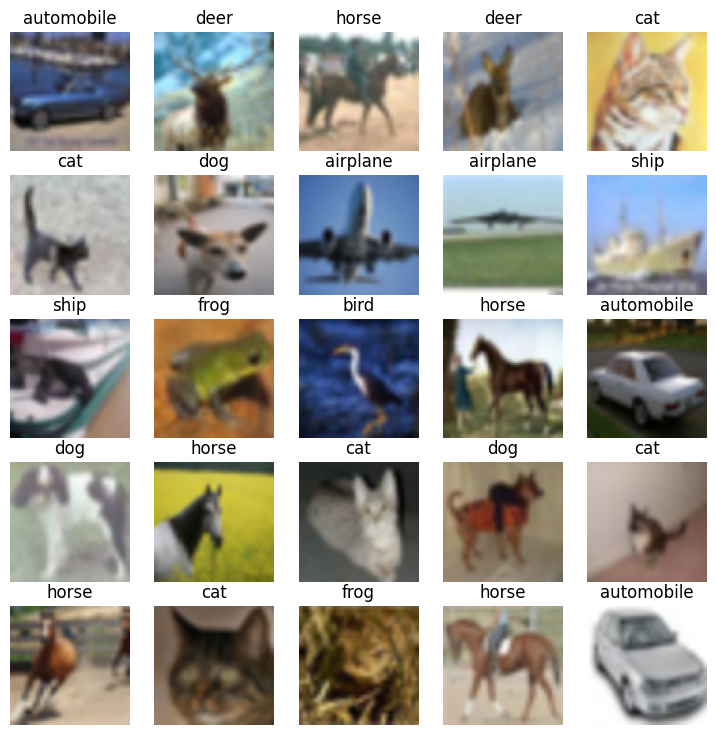

In [5]:
fig = plt.figure(figsize=(9, 9))
rows, cols = 5, 5
for i in range(1, rows * cols + 1):
    random_idx = torch.randint(0, len(train_dataset), size=(1,)).item()
    image, label = train_dataset[random_idx]
    image_np = image*0.5+0.5
    image_np = image_np.permute(1, 2, 0).numpy()
    fig.add_subplot(rows, cols, i)
    plt.imshow(image_np.squeeze())
    plt.title(classes_list[label])
    plt.axis(False)

In [6]:
z_dim = 64
feature_map = 64
output_channels = 3
lr = 2e-4
epochs = 10
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

In [7]:
class Generator(torch.nn.Module):
    def __init__(self, z_dim = z_dim, feature_map = feature_map, output_channels = 3):
        super(Generator, self).__init__()
        self.gan_gen = torch.nn.Sequential(
            nn.ConvTranspose2d(z_dim, feature_map*8, kernel_size=4, stride=1, padding=0, bias=False), #Start with a rich network (i.e featuremap * 8)
            nn.BatchNorm2d(feature_map*8),
            nn.ReLU(True),

            nn.ConvTranspose2d(feature_map*8, feature_map*4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_map*4),
            nn.ReLU(True),

            nn.ConvTranspose2d(feature_map*4, feature_map*2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_map*2),
            nn.ReLU(True),

            nn.ConvTranspose2d(feature_map*2, feature_map, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_map),
            nn.ReLU(True),

            nn.ConvTranspose2d(feature_map, output_channels, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
        return self.gan_gen(z)

class Discriminator(nn.Module):
    def __init__(self, image_channels =3, feature_map = 64):
        super().__init__()
        self.gan_disc = nn.Sequential(
            nn.Conv2d(image_channels, feature_map, kernel_size=4,stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            #Shape = (batchsize, 64,16,16)

            nn.Conv2d(feature_map, feature_map*2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_map*2),
            nn.LeakyReLU(0.2, inplace=True),
            #Shape = (batchsize, 128,8,8)

            nn.Conv2d(feature_map*2, feature_map*4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_map*4),
            nn.LeakyReLU(0.2, inplace=True),
            #Shape = (batchsize, 256,4,4)

            nn.Conv2d(feature_map*4, feature_map*8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_map*8),
            nn.LeakyReLU(0.2, inplace=True),
            #Shape = (batchsize, 512,2,2)

            nn.Conv2d(feature_map*8, 1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
            #output(batchsize, 1,1,1)-> probability of "real"
        )
    def forward(self, x):
        return self.gan_disc(x).flatten(start_dim=1)



In [8]:
import torch.nn as nn

def initialize_weights(model):
    """
    Apply DCGAN-specific weight initialization.

    Args:
        model: Any nn.Module (Generator or Discriminator).
    """
    for layer in model.modules():
        # Convolutional layers
        if isinstance(layer, (nn.Conv2d, nn.ConvTranspose2d)):
            nn.init.normal_(layer.weight.data, mean=0.0, std=0.02)

        # BatchNorm layers
        elif isinstance(layer, nn.BatchNorm2d):
            nn.init.normal_(layer.weight.data, mean=1.0, std=0.02)
            nn.init.constant_(layer.bias.data, 0.0)

In [ ]:
# generator = Generator().to(device=DEVICE)
# discriminator = Discriminator().to(device=DEVICE)

# initialize_weights(generator)
# initialize_weights(discriminator)
# discriminator, generator

(Discriminator(
   (gan_disc): Sequential(
     (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (1): LeakyReLU(negative_slope=0.2, inplace=True)
     (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (4): LeakyReLU(negative_slope=0.2, inplace=True)
     (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (7): LeakyReLU(negative_slope=0.2, inplace=True)
     (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (10): LeakyReLU(negative_slope=0.2, inplace=True)
     (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
     (12): Sigmoid()
   )
 ),
 Generat

In [ ]:
loss_function = nn.BCELoss()
# gen_optimizer = torch.optim.Adam(generator.parameters(), lr = lr, betas=(0.5,0.999))
# disc_optimizer = torch.optim.Adam(discriminator.parameters(), lr = lr, betas=(0.5,0.999))

results_gan = {
    "Disc Loss": [],
    "Gen Loss": [],
    "FID Score": [],
    "Mean Inception Score": [],
    "Std Inception Score": [],
    "steps": []
}

fixed_noise = torch.randn(64, z_dim, 1, 1, device=DEVICE)

os.makedirs("gan_checkpoints", exist_ok=True)
os.makedirs("gan_samples", exist_ok=True)
os.makedirs("real_dir", exist_ok=True)
os.makedirs("fake_dir", exist_ok=True)
real_dir_str = "./real_dir"
fake_dir_str = "./fake_dir"


step = 0

In [ ]:
# summary(generator, (1,z_dim,1,1)), summary(discriminator, (1,3,64,64))

(==========================================================================================
 Layer (type:depth-idx)                   Output Shape              Param #
 Generator                                [1, 3, 64, 64]            --
 ├─Sequential: 1-1                        [1, 3, 64, 64]            --
 │    └─ConvTranspose2d: 2-1              [1, 512, 4, 4]            524,288
 │    └─BatchNorm2d: 2-2                  [1, 512, 4, 4]            1,024
 │    └─ReLU: 2-3                         [1, 512, 4, 4]            --
 │    └─ConvTranspose2d: 2-4              [1, 256, 8, 8]            2,097,152
 │    └─BatchNorm2d: 2-5                  [1, 256, 8, 8]            512
 │    └─ReLU: 2-6                         [1, 256, 8, 8]            --
 │    └─ConvTranspose2d: 2-7              [1, 128, 16, 16]          524,288
 │    └─BatchNorm2d: 2-8                  [1, 128, 16, 16]          256
 │    └─ReLU: 2-9                         [1, 128, 16, 16]          --
 │    └─ConvTranspose2d: 2-10

In [18]:
inception = torchvision.models.inception_v3(pretrained=True).eval().to(DEVICE)
inception.fc = torch.nn.Identity()

In [19]:
def compute_inception_score(images, splits=10):
    """
    images: Tensor of shape [N, 3, H, W], range [0,1]
    splits: Number of splits to reduce variance
    """
    assert torch.min(images) >= 0 and torch.max(images) <= 1, "Images must be in [0,1]"

    # Resize to Inception input (299x299) if needed
    if images.shape[-1] != 299:
        images = F.interpolate(images, size=(299, 299), mode="bilinear", align_corners=False)

    # Get softmax probabilities
    with torch.no_grad():
        logits = inception(images)
        probs = torch.nn.functional.softmax(logits, dim=1).cpu().numpy()

    # Compute IS per split
    N = probs.shape[0]
    split_scores = []
    for k in range(splits):
        part = probs[k * (N // splits): (k + 1) * (N // splits), :]
        p_y = np.mean(part, axis=0)
        kl = part * (np.log(part + 1e-6) - np.log(p_y + 1e-6))
        kl = np.mean(np.sum(kl, axis=1))
        split_scores.append(np.exp(kl))

    return float(np.mean(split_scores)), float(np.std(split_scores))
torch.cuda.empty_cache()


Epoch [1/10] Step [0] Loss_D: 1.3381 | Loss_G: 6.8442


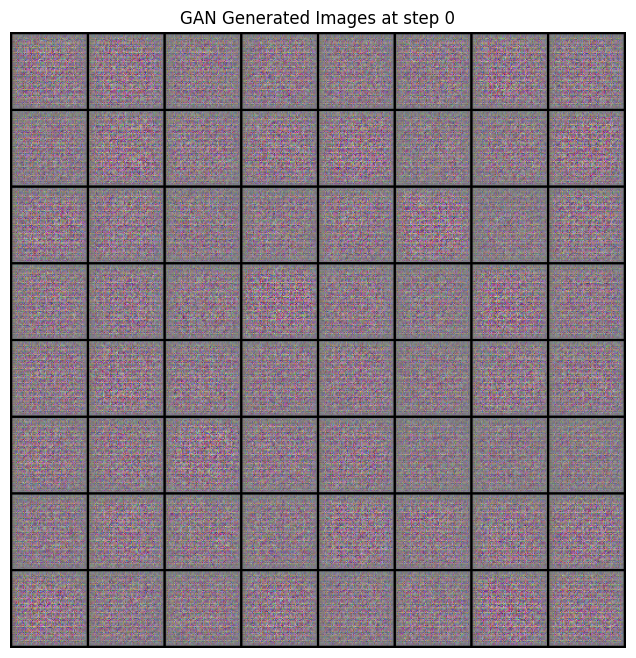

GAN checkpoint saved at step 0
Epoch [1/10] Step [100] Loss_D: 0.3446 | Loss_G: 4.4560


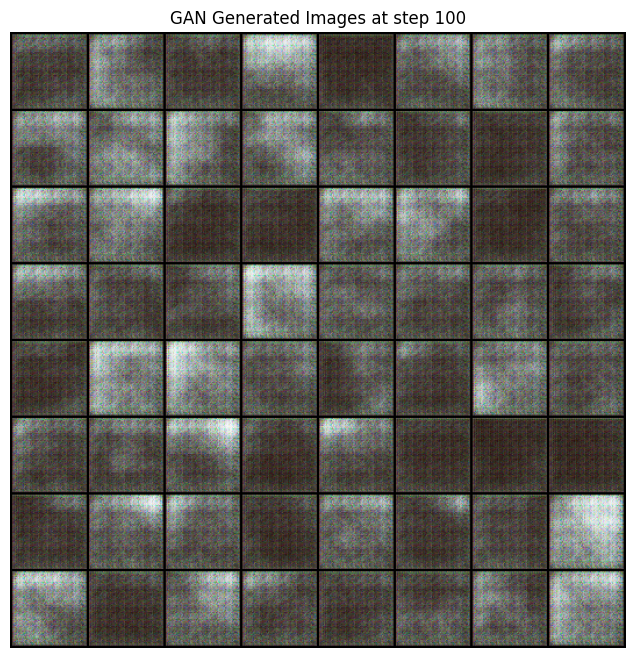

Epoch [1/10] Step [200] Loss_D: 0.1553 | Loss_G: 5.2508


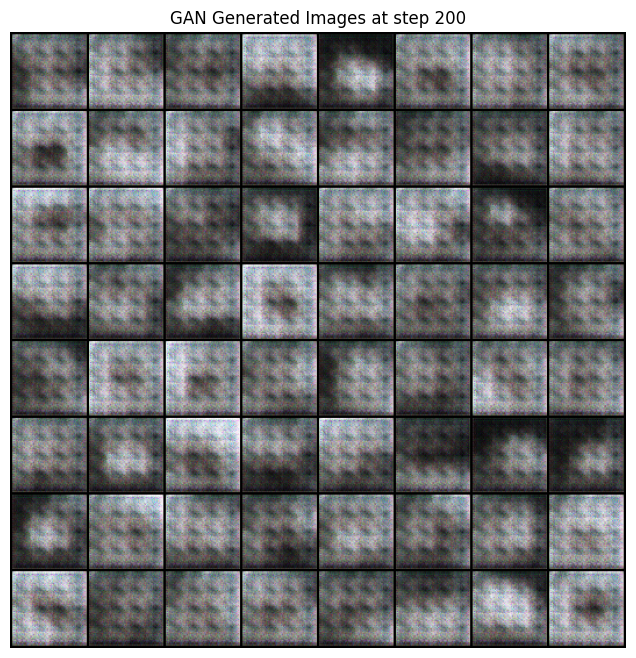

Epoch [1/10] Step [300] Loss_D: 0.8241 | Loss_G: 4.0029


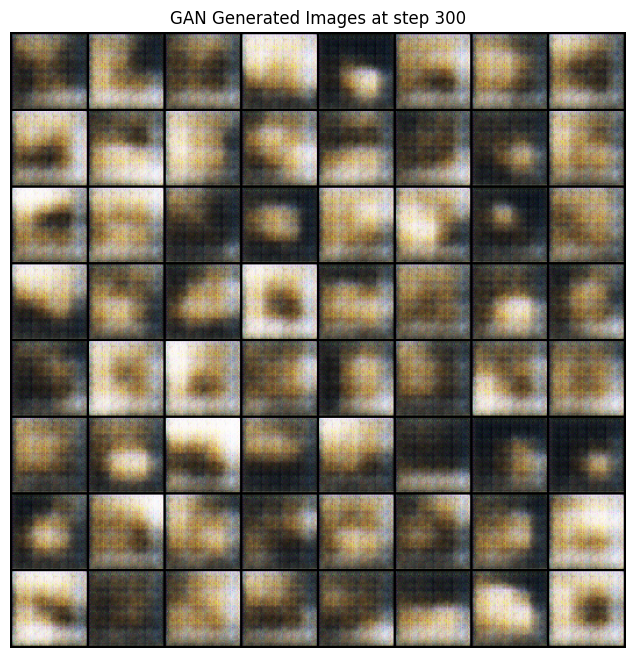

100%|██████████| 5/5 [00:02<00:00,  2.24it/s]


Inception Score: 1.0225 ± 0.0052

Epoch [1/10] Summary:
Discriminator Loss: 0.4843
Generator Loss:     7.7662
FID Score:          299.2673
Inception Score:    1.0225 ± 0.0052
Epoch [2/10] Step [400] Loss_D: 0.6439 | Loss_G: 3.7161


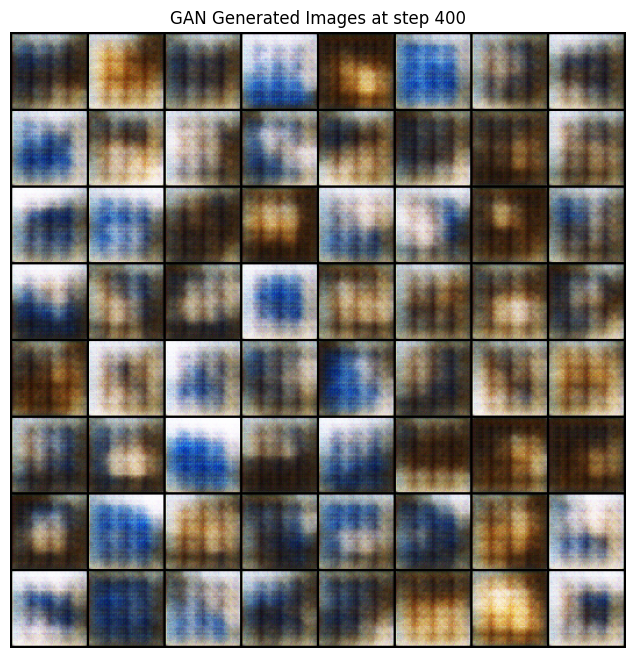

Epoch [2/10] Step [500] Loss_D: 0.3632 | Loss_G: 4.0656


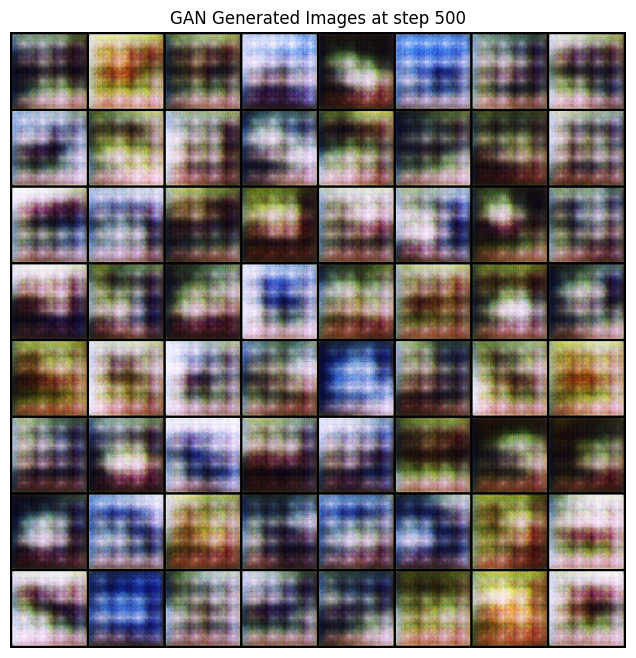

Epoch [2/10] Step [600] Loss_D: 0.4133 | Loss_G: 2.7783


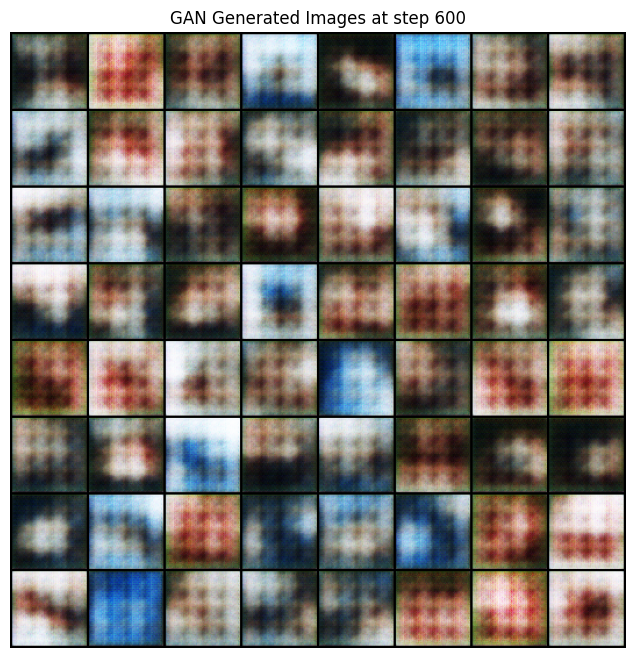

Epoch [2/10] Step [700] Loss_D: 0.3880 | Loss_G: 3.7513


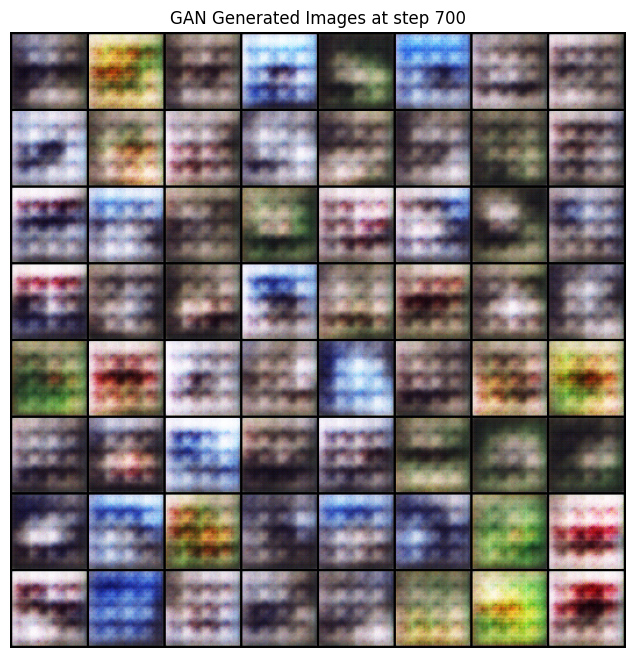

100%|██████████| 5/5 [00:02<00:00,  2.22it/s]


Inception Score: 1.0324 ± 0.0020

Epoch [2/10] Summary:
Discriminator Loss: 0.6663
Generator Loss:     4.2734
FID Score:          310.1772
Inception Score:    1.0324 ± 0.0020
Epoch [3/10] Step [800] Loss_D: 0.7780 | Loss_G: 2.0524


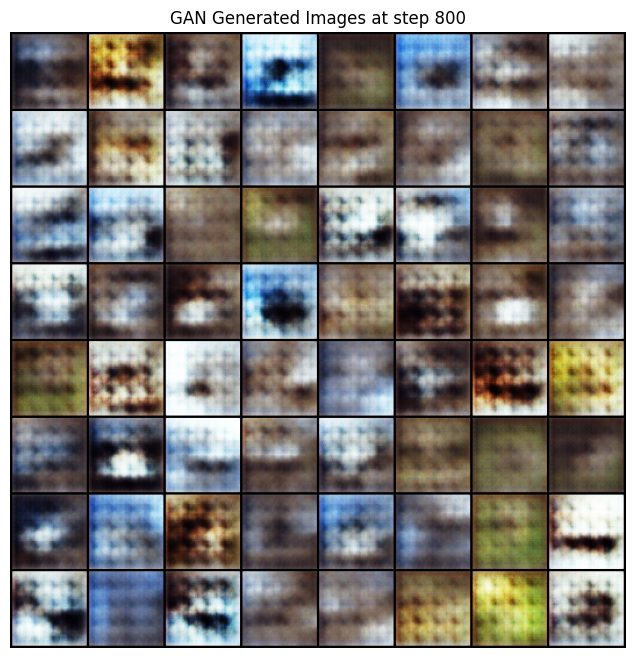

Epoch [3/10] Step [900] Loss_D: 0.5035 | Loss_G: 4.4477


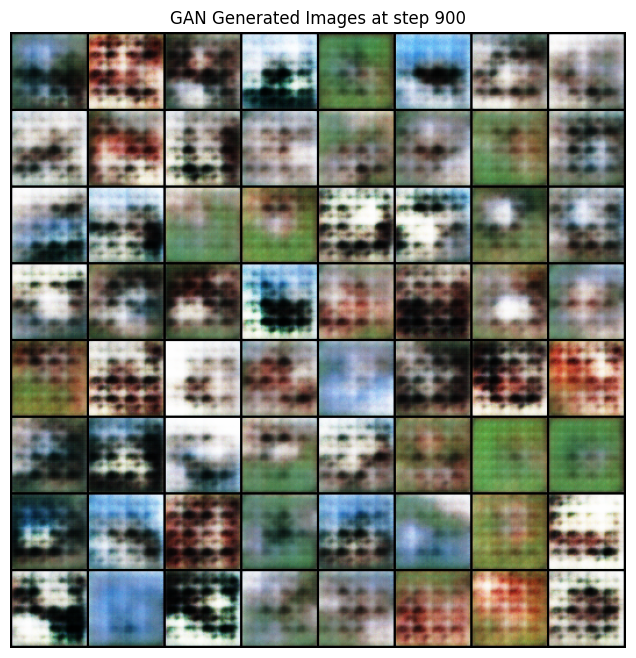

Epoch [3/10] Step [1000] Loss_D: 0.9414 | Loss_G: 4.1657


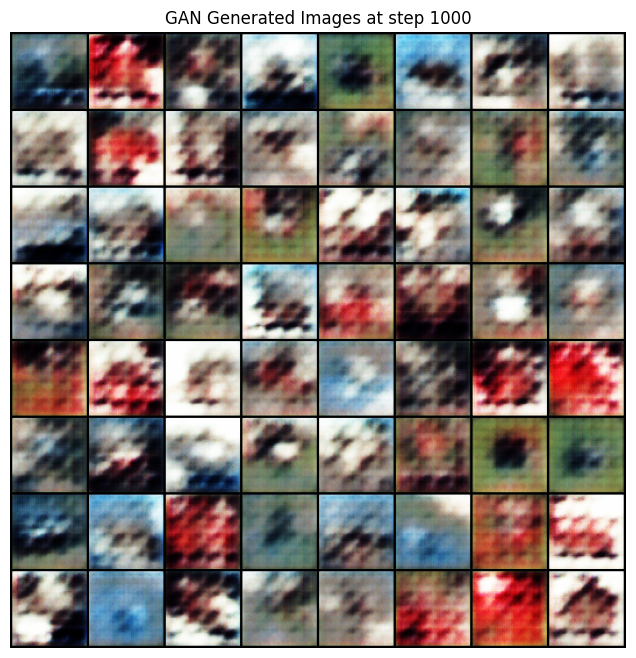

GAN checkpoint saved at step 1000
Epoch [3/10] Step [1100] Loss_D: 0.4371 | Loss_G: 3.3028


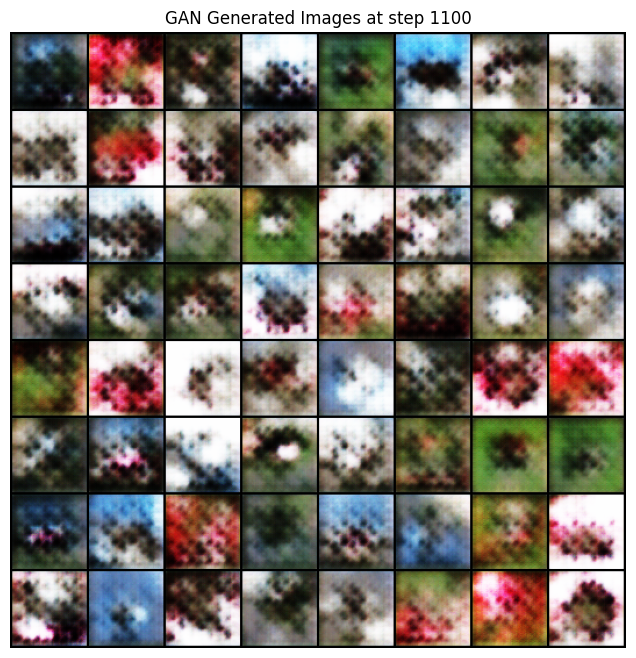

100%|██████████| 5/5 [00:02<00:00,  2.17it/s]


Inception Score: 1.0354 ± 0.0024

Epoch [3/10] Summary:
Discriminator Loss: 0.6643
Generator Loss:     3.6688
FID Score:          313.8633
Inception Score:    1.0354 ± 0.0024
Epoch [4/10] Step [1200] Loss_D: 0.7099 | Loss_G: 3.3279


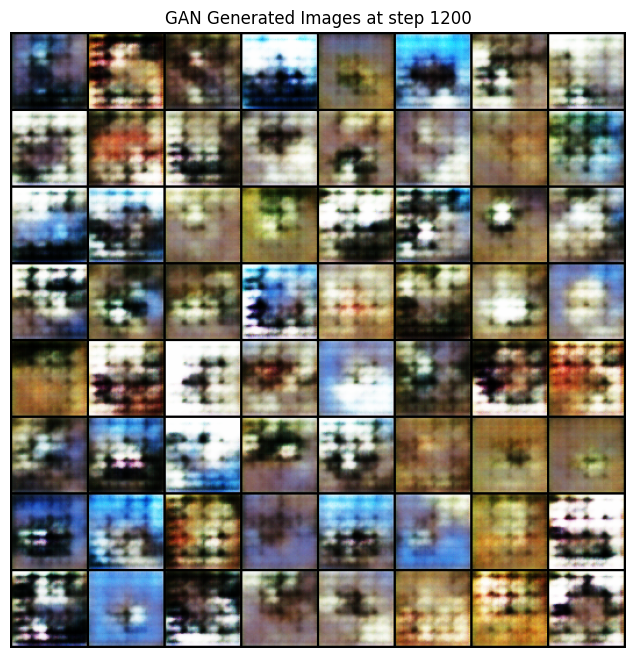

Epoch [4/10] Step [1300] Loss_D: 0.9504 | Loss_G: 1.9809


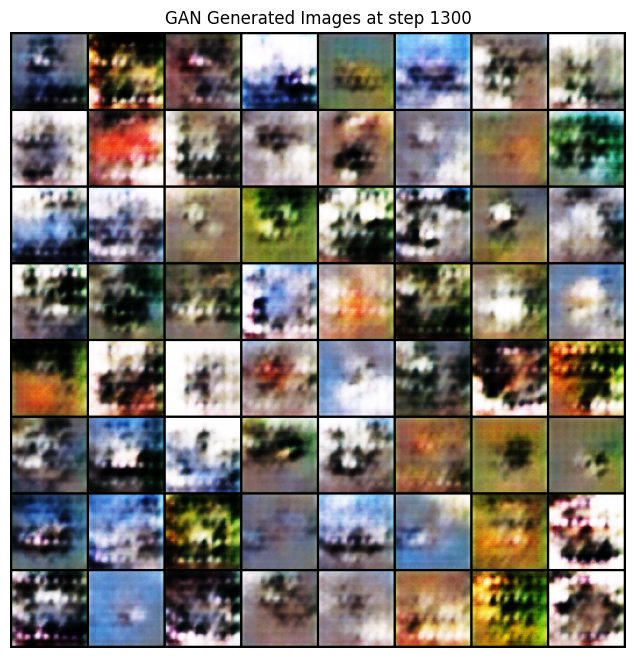

Epoch [4/10] Step [1400] Loss_D: 0.3731 | Loss_G: 3.5426


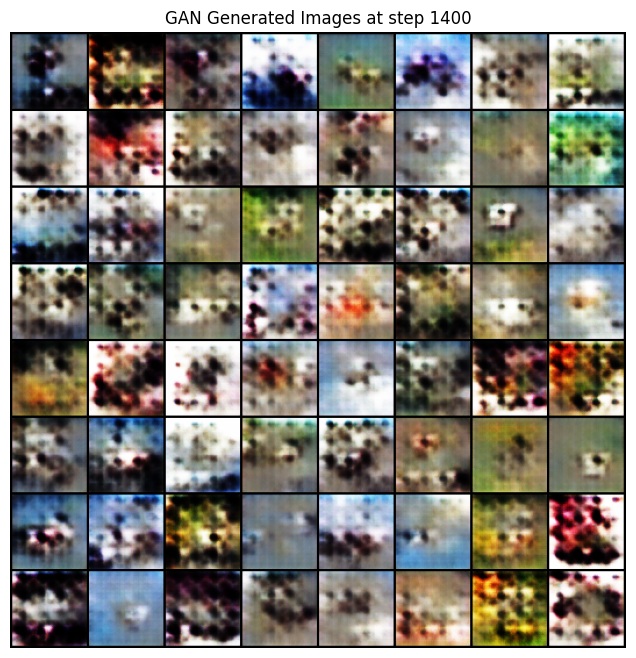

Epoch [4/10] Step [1500] Loss_D: 1.2693 | Loss_G: 2.2696


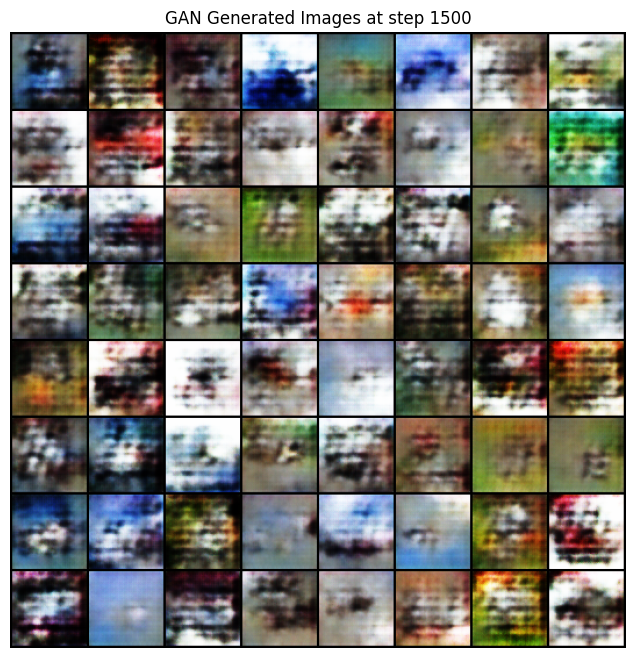

100%|██████████| 5/5 [00:02<00:00,  2.17it/s]


Inception Score: 1.0810 ± 0.0053

Epoch [4/10] Summary:
Discriminator Loss: 0.7132
Generator Loss:     3.3934
FID Score:          282.5087
Inception Score:    1.0810 ± 0.0053
Epoch [5/10] Step [1600] Loss_D: 0.3362 | Loss_G: 3.0599


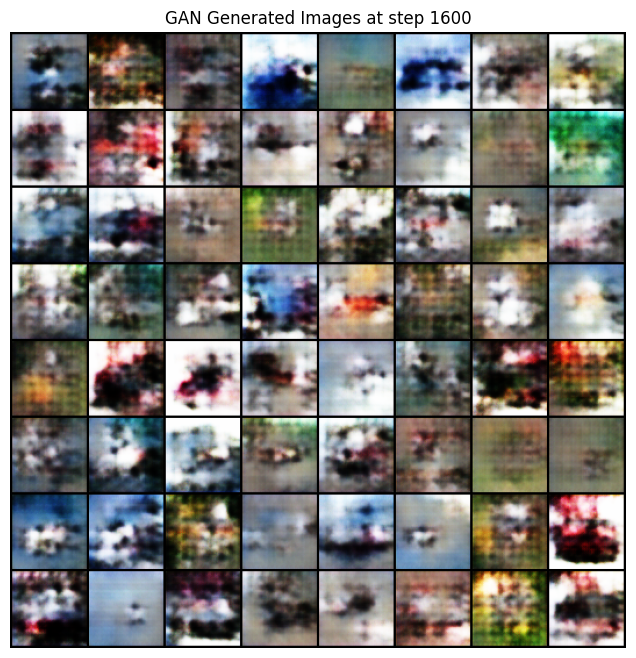

Epoch [5/10] Step [1700] Loss_D: 0.8949 | Loss_G: 2.0889


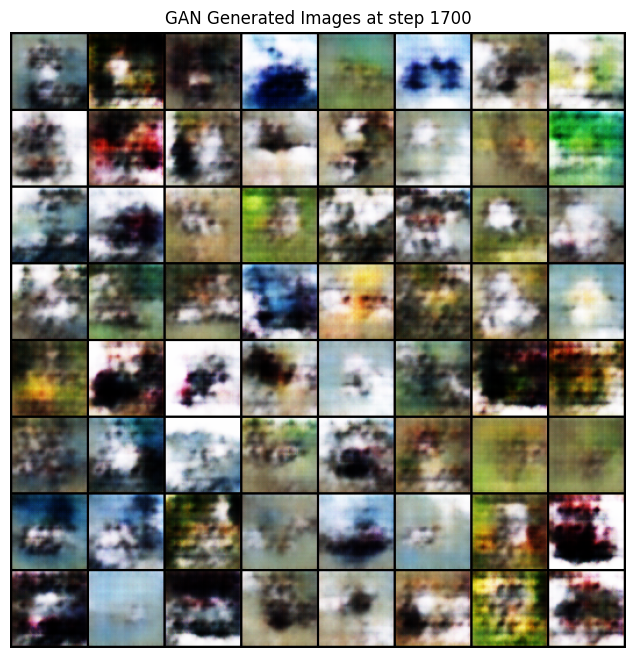

Epoch [5/10] Step [1800] Loss_D: 2.3642 | Loss_G: 0.8946


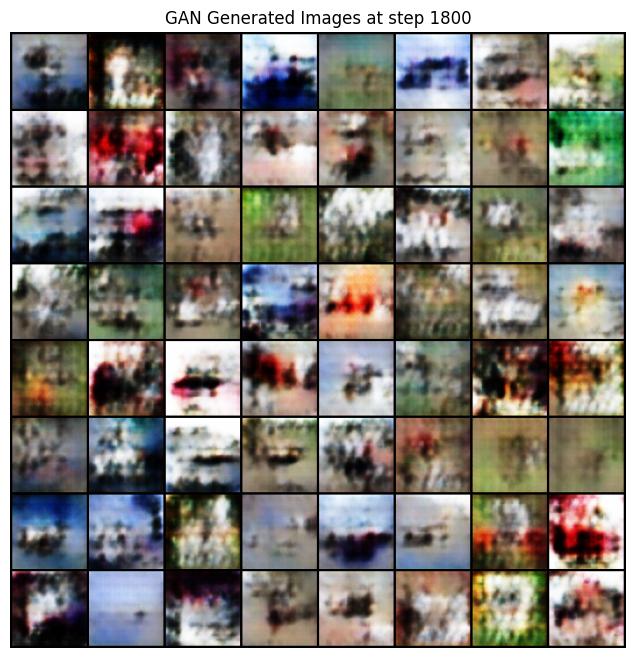

Epoch [5/10] Step [1900] Loss_D: 0.4780 | Loss_G: 2.6738


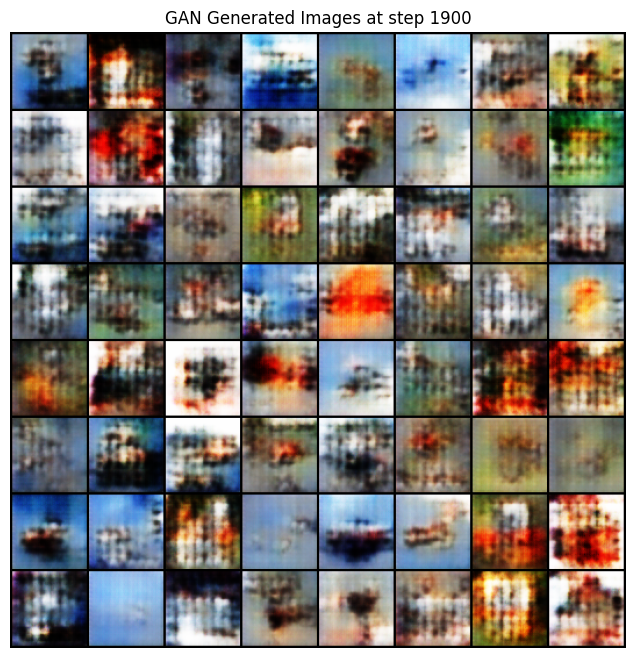

100%|██████████| 5/5 [00:02<00:00,  2.20it/s]


Inception Score: 1.0824 ± 0.0113

Epoch [5/10] Summary:
Discriminator Loss: 0.6730
Generator Loss:     3.1051
FID Score:          266.5096
Inception Score:    1.0824 ± 0.0113
Epoch [6/10] Step [2000] Loss_D: 0.3684 | Loss_G: 2.9703


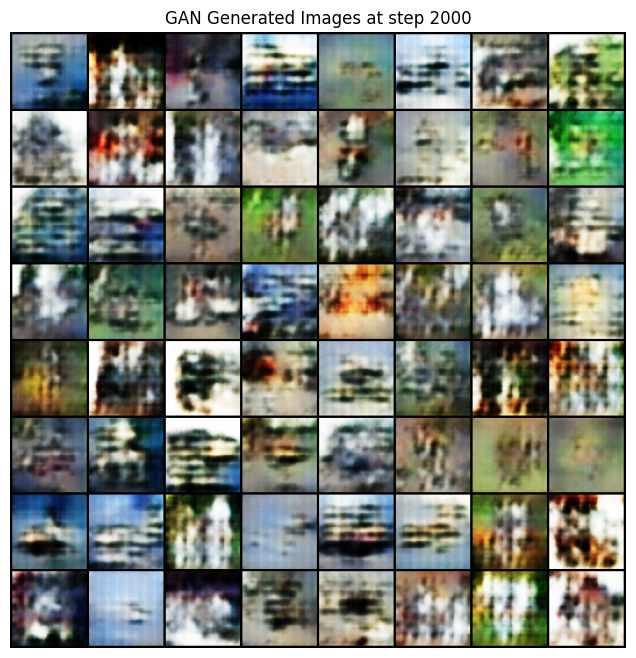

GAN checkpoint saved at step 2000
Epoch [6/10] Step [2100] Loss_D: 0.5083 | Loss_G: 2.3340


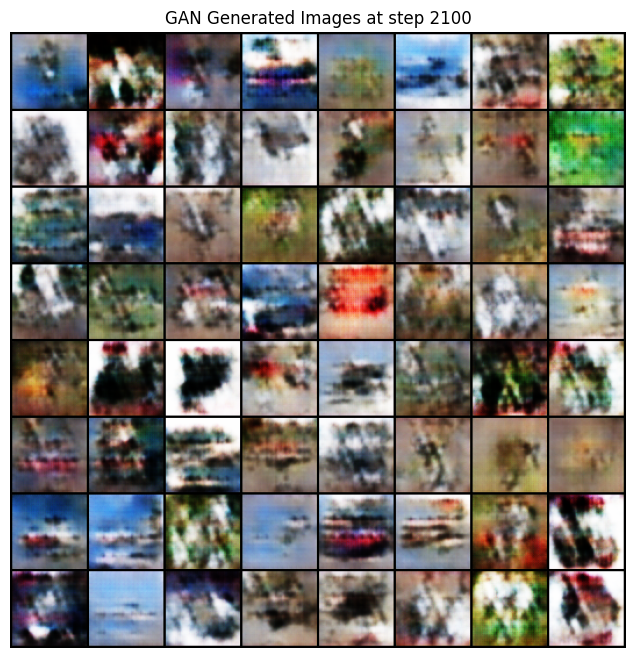

Epoch [6/10] Step [2200] Loss_D: 0.5424 | Loss_G: 3.4878


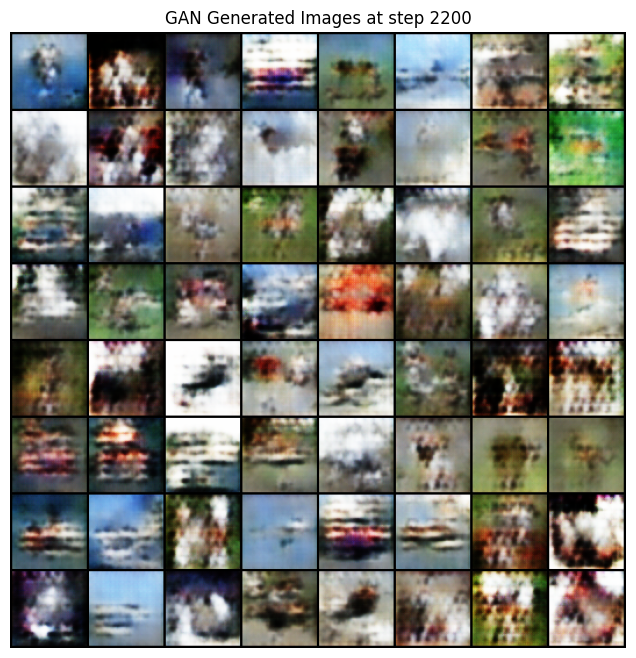

Epoch [6/10] Step [2300] Loss_D: 0.6101 | Loss_G: 2.3190


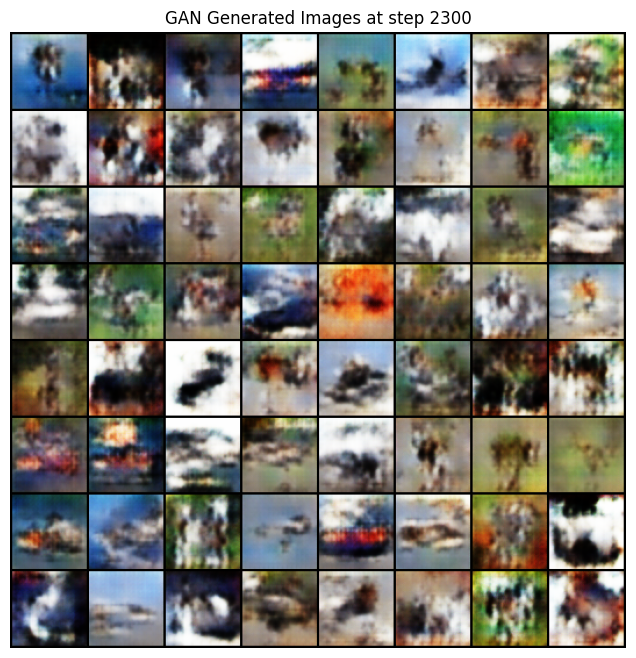

100%|██████████| 5/5 [00:02<00:00,  2.19it/s]


Inception Score: 1.0883 ± 0.0089

Epoch [6/10] Summary:
Discriminator Loss: 0.7691
Generator Loss:     2.9002
FID Score:          249.5636
Inception Score:    1.0883 ± 0.0089
Epoch [7/10] Step [2400] Loss_D: 1.0798 | Loss_G: 4.7003


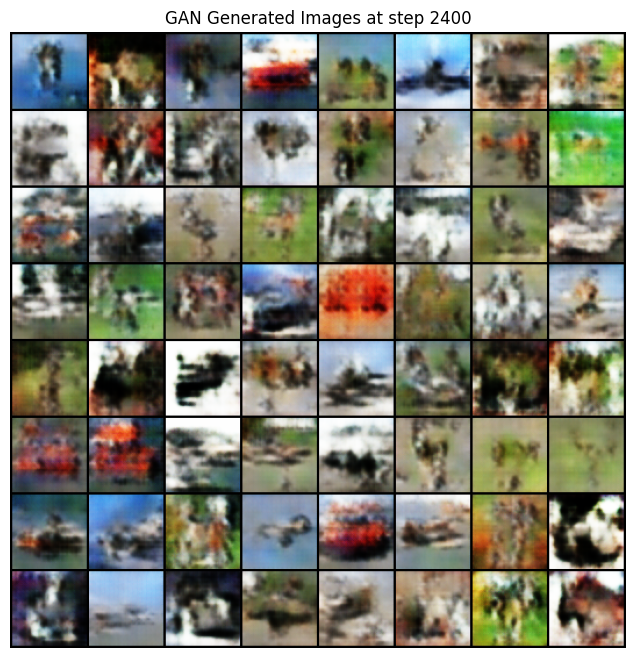

Epoch [7/10] Step [2500] Loss_D: 0.8186 | Loss_G: 1.5114


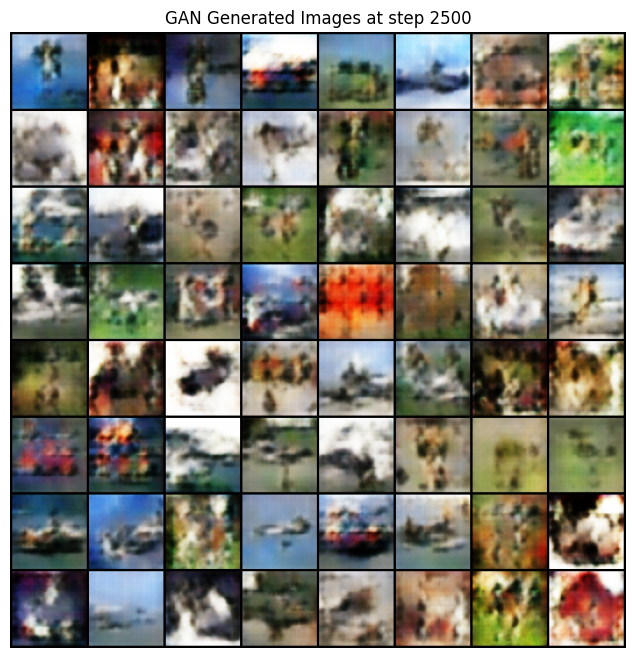

Epoch [7/10] Step [2600] Loss_D: 0.4625 | Loss_G: 2.3003


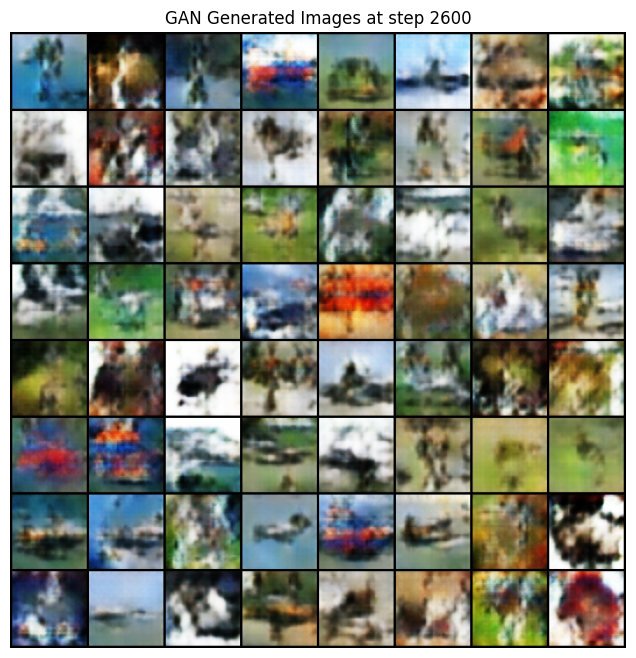

Epoch [7/10] Step [2700] Loss_D: 0.7340 | Loss_G: 3.1300


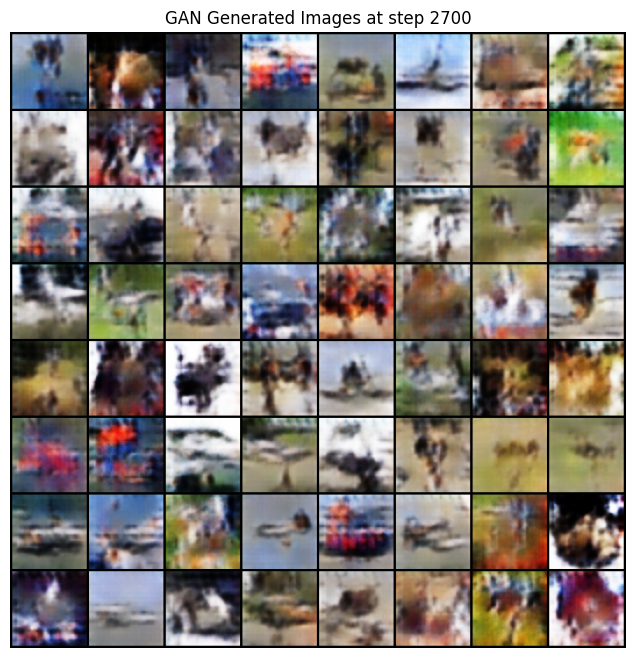

100%|██████████| 5/5 [00:02<00:00,  2.17it/s]


Inception Score: 1.1246 ± 0.0156

Epoch [7/10] Summary:
Discriminator Loss: 0.8577
Generator Loss:     2.6852
FID Score:          221.2897
Inception Score:    1.1246 ± 0.0156
Epoch [8/10] Step [2800] Loss_D: 0.5594 | Loss_G: 2.6904


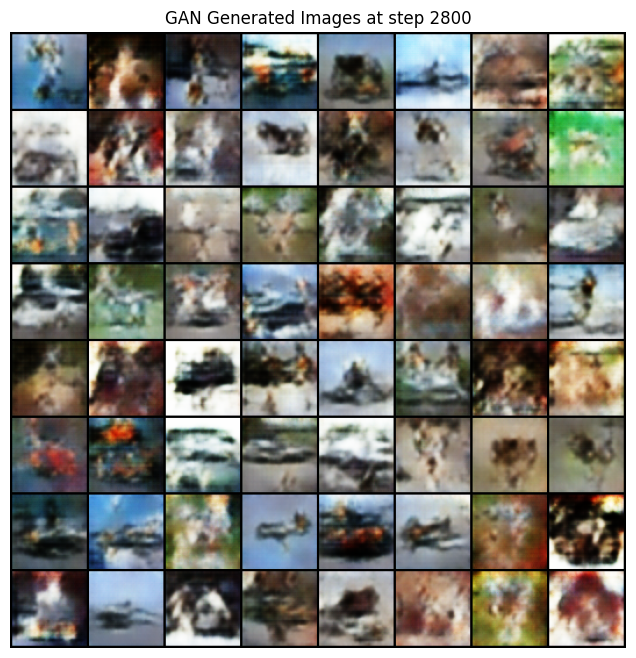

Epoch [8/10] Step [2900] Loss_D: 0.3918 | Loss_G: 2.2966


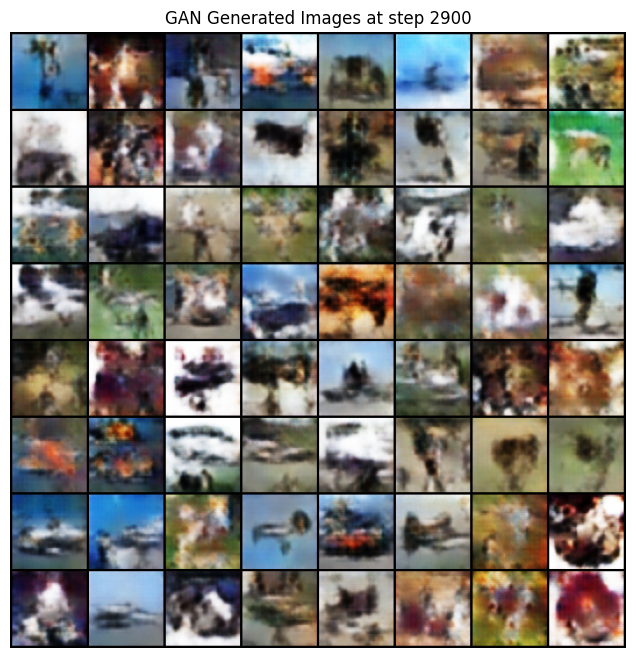

Epoch [8/10] Step [3000] Loss_D: 0.6054 | Loss_G: 1.9180


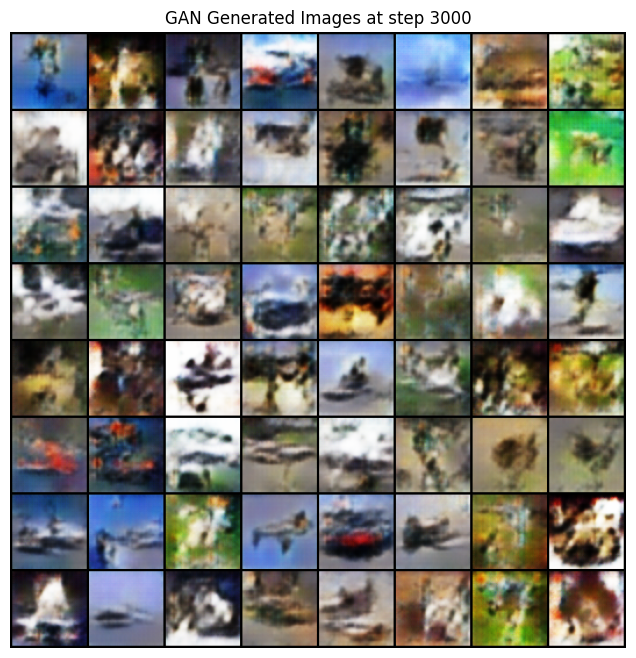

GAN checkpoint saved at step 3000
Epoch [8/10] Step [3100] Loss_D: 0.3817 | Loss_G: 2.4488


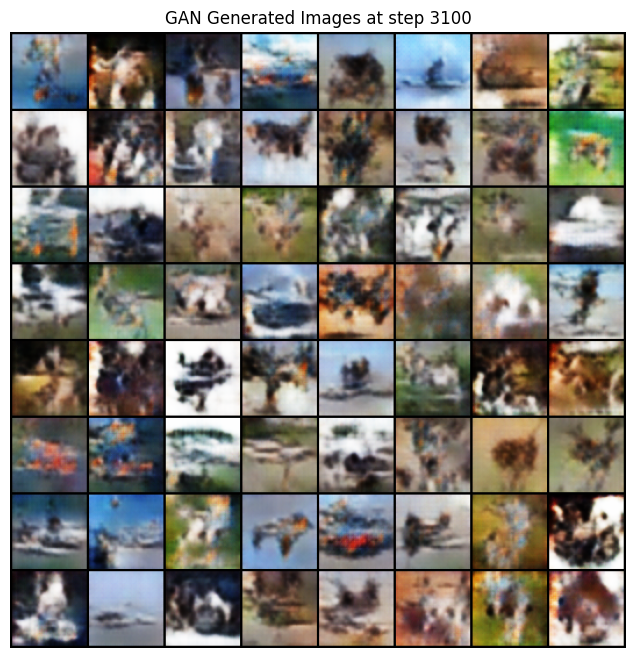

100%|██████████| 5/5 [00:02<00:00,  2.18it/s]


Inception Score: 1.1303 ± 0.0159

Epoch [8/10] Summary:
Discriminator Loss: 0.8385
Generator Loss:     2.6147
FID Score:          235.5377
Inception Score:    1.1303 ± 0.0159
Epoch [9/10] Step [3200] Loss_D: 1.5059 | Loss_G: 1.0639


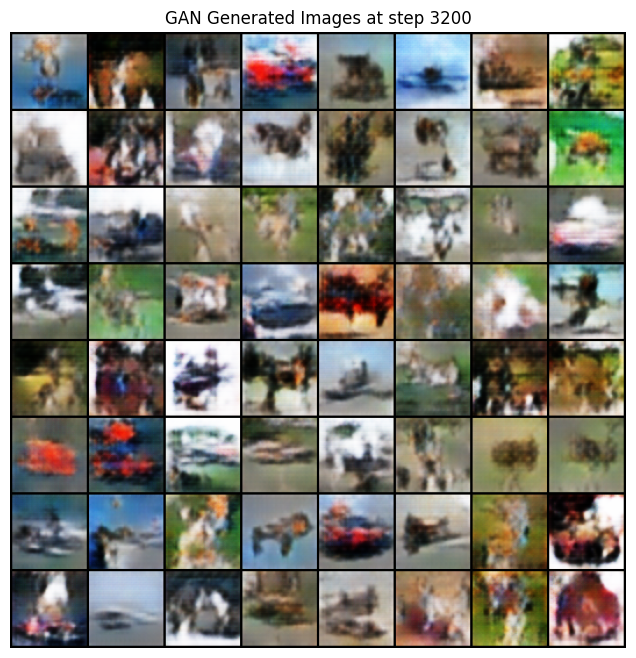

Epoch [9/10] Step [3300] Loss_D: 0.5632 | Loss_G: 4.1145


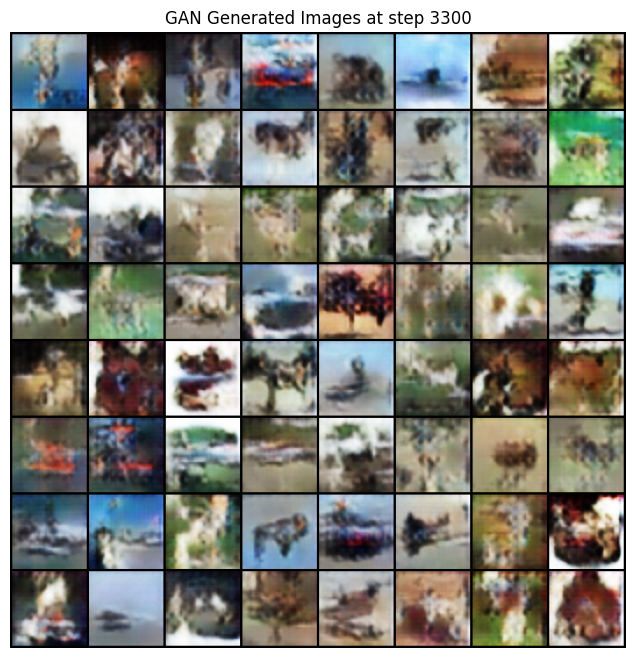

Epoch [9/10] Step [3400] Loss_D: 1.3055 | Loss_G: 1.7601


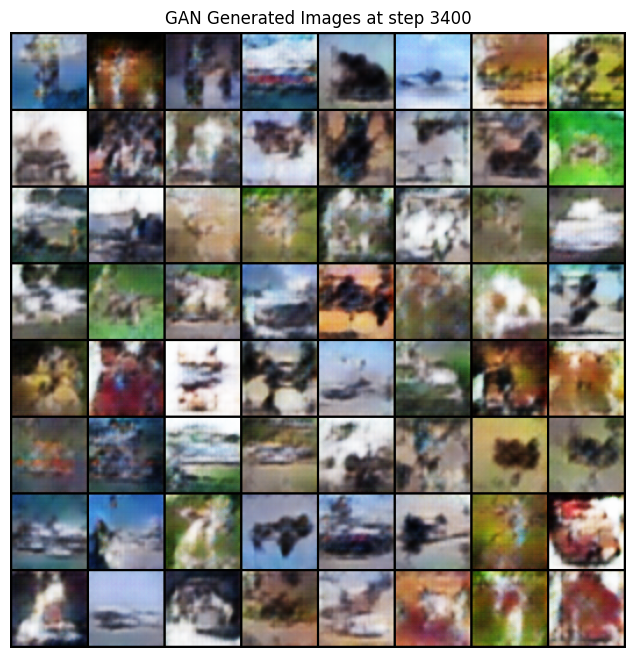

Epoch [9/10] Step [3500] Loss_D: 0.4915 | Loss_G: 2.9243


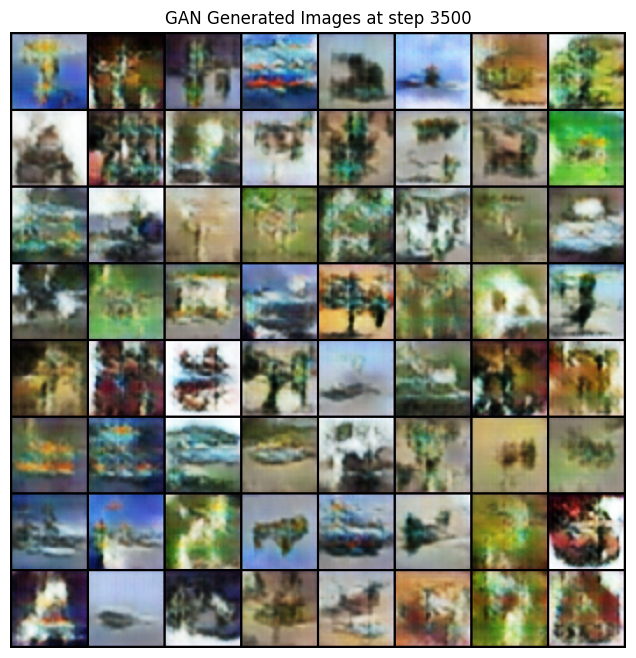

100%|██████████| 5/5 [00:02<00:00,  2.15it/s]


Inception Score: 1.1159 ± 0.0152

Epoch [9/10] Summary:
Discriminator Loss: 0.8173
Generator Loss:     2.6838
FID Score:          186.3051
Inception Score:    1.1159 ± 0.0152
Epoch [10/10] Step [3600] Loss_D: 0.2361 | Loss_G: 3.8213


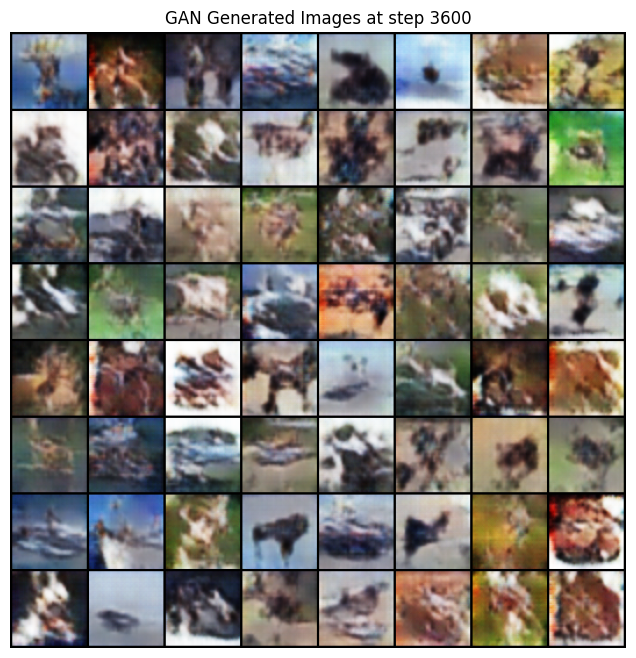

Epoch [10/10] Step [3700] Loss_D: 1.0437 | Loss_G: 2.0358


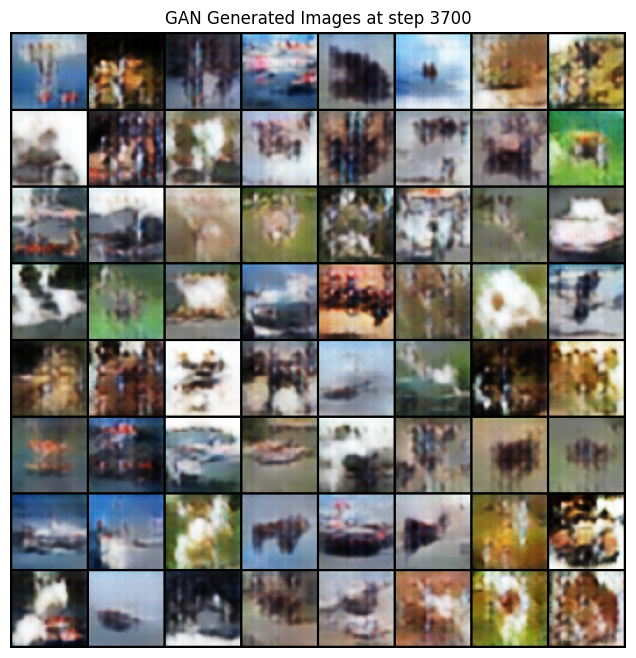

Epoch [10/10] Step [3800] Loss_D: 0.2737 | Loss_G: 3.3698


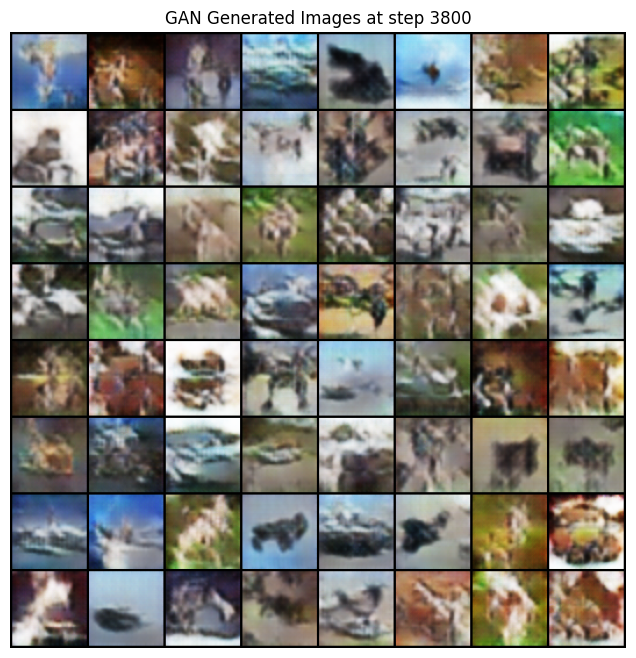

Epoch [10/10] Step [3900] Loss_D: 0.9693 | Loss_G: 1.6205


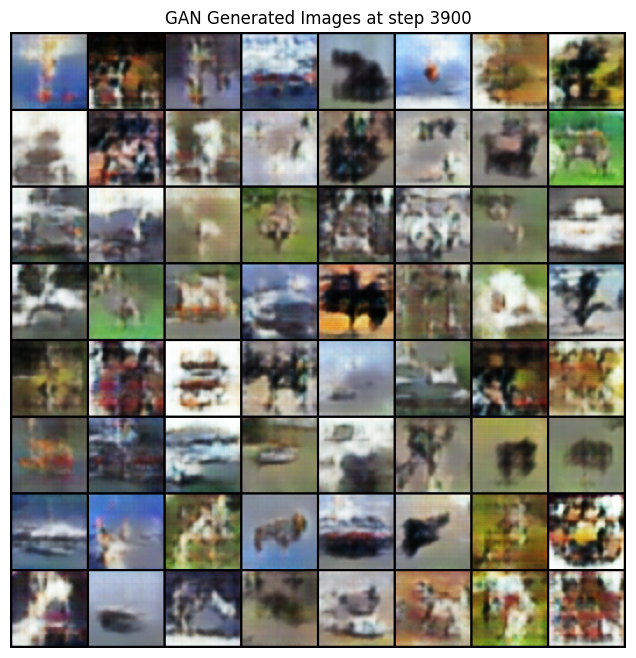

100%|██████████| 5/5 [00:02<00:00,  2.21it/s]


Inception Score: 1.1204 ± 0.0191

Epoch [10/10] Summary:
Discriminator Loss: 0.8135
Generator Loss:     2.6853
FID Score:          231.0575
Inception Score:    1.1204 ± 0.0191
GAN training completed!
Results saved to gan_training_metrics.json


In [ ]:
# for epoch in range(epochs):
#     epoch_disc_loss, epoch_gen_loss = 0.0, 0.0
#     train_batches = 0

#     for batch_idx, (real_image, _) in enumerate(train_data):
#         real_image = real_image.to(DEVICE)
#         batch_size = real_image.size(0)

#         real_labels = torch.ones(batch_size, 1, device=DEVICE)
#         fake_labels = torch.zeros(batch_size, 1, device=DEVICE)

#         # ------------------- Train Discriminator -------------------
#         disc_optimizer.zero_grad()

#         real_output = discriminator(real_image).view(-1, 1)
#         loss_real = loss_function(real_output, real_labels)

#         noise = torch.randn(batch_size, z_dim, 1, 1, device=DEVICE)
#         fake_images = generator(noise)
#         fake_output = discriminator(fake_images.detach()).view(-1, 1)
#         loss_fake = loss_function(fake_output, fake_labels)

#         disc_loss = loss_real + loss_fake
#         disc_loss.backward()
#         disc_optimizer.step()

#         # ------------------- Train Generator -------------------
#         gen_optimizer.zero_grad()
#         fake_output = discriminator(fake_images).view(-1, 1)
#         gen_loss = loss_function(fake_output, real_labels)
#         gen_loss.backward()
#         gen_optimizer.step()

#         epoch_disc_loss += disc_loss.item()
#         epoch_gen_loss += gen_loss.item()
#         train_batches += 1

#         # ------------------- Logging / Visualization -------------------
#         if step % 100 == 0:
#             print(
#                 f"Epoch [{epoch+1}/{epochs}] Step [{step}] "
#                 f"Loss_D: {disc_loss.item():.4f} | Loss_G: {gen_loss.item():.4f}"
#             )
#             with torch.inference_mode():
#                 fake_samples = generator(fixed_noise).detach().cpu()
#             vutils.save_image(
#                 fake_samples,
#                 f"gan_samples/fake_step_{step}.png",
#                 normalize=True,
#                 nrow=8
#             )
#             grid = vutils.make_grid(fake_samples[:64], nrow=8, normalize=True)
#             npimg = grid.permute(1, 2, 0).numpy()
#             plt.figure(figsize=(8, 8))
#             plt.imshow(npimg)
#             plt.title(f"GAN Generated Images at step {step}")
#             plt.axis("off")
#             plt.show()

#         # ------------------- Checkpoint -------------------
#         if step % 1000 == 0:
#             checkpoint = {
#                 "generator_state": generator.state_dict(),
#                 "discriminator_state": discriminator.state_dict(),
#                 "optimizer_G_state": gen_optimizer.state_dict(),
#                 "optimizer_D_state": disc_optimizer.state_dict(),
#                 "step": step,
#                 "epoch": epoch,
#                 "results": results_gan
#             }
#             torch.save(checkpoint, f"gan_checkpoints/dcgan_step_{step}.pt")
#             print(f"GAN checkpoint saved at step {step}")

#         step += 1

#     # ------------------- Epoch Metrics -------------------
#     avg_disc_loss = epoch_disc_loss / train_batches
#     avg_gen_loss = epoch_gen_loss / train_batches

#     # Clean FID directories
#     for f in Path(real_dir_str).glob("*.png"):
#         f.unlink()
#     for f in Path(fake_dir_str).glob("*.png"):
#         f.unlink()

#     # Save a batch of real images (from training set)
#     num_real_saved = 0
#     for i, (images, _) in enumerate(train_data):
#         if num_real_saved >= 500:
#             break
#         for j, img in enumerate(images):
#             vutils.save_image(img, f"{real_dir_str}/real_{i}_{j}.png", normalize=True)
#             num_real_saved += 1

#     # Save a batch of generated fake images
#     with torch.inference_mode():
#         num_fake_saved = 0
#         all_fake_images = []  # 🔹NEW: store for IS calculation
#         while num_fake_saved < 500:
#             noise = torch.randn(batch_size, z_dim, 1, 1, device=DEVICE)
#             fake_images = generator(noise).detach().cpu()
#             all_fake_images.append(fake_images)  # 🔹NEW
#             for j, img in enumerate(fake_images):
#                 vutils.save_image(img, f"{fake_dir_str}/fake_{num_fake_saved+j}.png", normalize=True)
#             num_fake_saved += fake_images.size(0)
#         all_fake_images = torch.cat(all_fake_images, dim=0)  # 🔹NEW

#     # ------------------- FID Calculation -------------------
#     num_real = len(list(Path(real_dir_str).glob("*.png")))
#     num_fake = len(list(Path(fake_dir_str).glob("*.png")))
#     if num_real > 0 and num_fake > 0:
#         fid_value = fid_score.calculate_fid_given_paths(
#             [real_dir_str, fake_dir_str],
#             batch_size=128,
#             device=DEVICE,
#             dims=2048
#         )
#     else:
#         fid_value = None
#         print(f"[Warning] Skipping FID at epoch {epoch+1}: real={num_real}, fake={num_fake}")

#     # ------------------- Inception Score Calculation ------------------- 🔹NEW
#     with torch.inference_mode():
#         device = next(inception.parameters()).device
#         image_for_is = ((all_fake_images+1)/2).to(device)
#         inception_mean, inception_std = compute_inception_score(
#             image_for_is, splits=10
#         )
#     print(f"Inception Score: {inception_mean:.4f} ± {inception_std:.4f}")  # 🔹NEW

#     # Store metrics
#     results_gan["Disc Loss"].append(avg_disc_loss)
#     results_gan["Gen Loss"].append(avg_gen_loss)
#     results_gan["FID Score"].append(fid_value)
#     results_gan["Mean Inception Score"].append(inception_mean)
#     results_gan["Std Inception Score"].append(inception_std)  # 🔹NEW
#     results_gan["steps"].append(step)

#     print(f"\nEpoch [{epoch+1}/{epochs}] Summary:")
#     print(f"Discriminator Loss: {avg_disc_loss:.4f}")
#     print(f"Generator Loss:     {avg_gen_loss:.4f}")
#     print(f"FID Score:          {fid_value:.4f}")
#     print(f"Inception Score:    {inception_mean:.4f} ± {inception_std:.4f}")

#     # Save metrics to JSON
#     with open("gan_training_metrics.json", "w") as f:
#         json.dump(results_gan, f, indent=2)

#     torch.cuda.empty_cache()

# print("GAN training completed!")
# print("Results saved to gan_training_metrics.json")


In [ ]:
# results_gan["Disc Loss"].append(avg_disc_loss)
# results_gan["Gen Loss"].append(avg_gen_loss)
# results_gan["FID Score"].append(fid_value)
# results_gan["Mean Inception Score"].append(inception_mean)
# results_gan["Std Inception Score"].append(inception_std)  # 🔹NEW
# results_gan["steps"].append(step)

# checkpoint = {
#     "generator_state": generator.state_dict(),
#     "discriminator_state": discriminator.state_dict(),
#     "optimizer_G_state": gen_optimizer.state_dict(),
#     "optimizer_D_state": disc_optimizer.state_dict(),
#     "step": step,
#     "epoch": epoch,
#     "results": results_gan
# }
# torch.save(checkpoint, f"gan_checkpoints/dcgan_step_{step}.pt")
# print(f"GAN checkpoint saved at step {step}")


GAN checkpoint saved at step 3910


In [ ]:
# with open("gan_training_metrics.json", "w") as f:
#         json.dump(results_gan, f, indent=2)

In [24]:
fixed_noise = torch.randn(64, z_dim, 1, 1, device=DEVICE)


### Loading checkpoint

In [14]:
checkpoint = torch.load("./gan_checkpoints/dcgan_step_3910.pt", map_location=DEVICE, weights_only=False)
checkpoint_generator = Generator().to(DEVICE)
checkpoint_discriminator = Discriminator().to(DEVICE)

checkpoint_generator.load_state_dict(checkpoint["generator_state"])
checkpoint_discriminator.load_state_dict(checkpoint["discriminator_state"])

checkpoint_discriminator.eval()
checkpoint_generator.eval()

with open("gan_training_metrics.json", "r") as f:
    dcgan_metrics = json.load(f)

In [16]:
import pandas as pd
from IPython.display import display

flat_metrics = {k:v for k,v in dcgan_metrics.items() if isinstance(v,list)}
df = pd.DataFrame(flat_metrics)
df.index = range(1,len(df)+1)
df.index.name = "Epoch"
df = df.drop('steps', axis=1)
display(df)
df.to_csv("DCGAN_metrics_table.csv", index=True)

,Disc Loss,Gen Loss,FID Score,Mean Inception Score,Std Inception Score
Epoch,,,,,
1,0.484267,7.766190,299.267328,1.022491,0.005176
2,0.666269,4.273418,310.177167,1.032363,0.002012
3,0.664307,3.668783,313.863287,1.035379,0.002380
4,0.713161,3.393356,282.508746,1.080967,0.005326
5,0.673036,3.105109,266.509625,1.082406,0.011296
6,0.769148,2.900194,249.563589,1.088258,0.008904
7,0.857728,2.685200,221.289678,1.124608,0.015624
8,0.838491,2.614739,235.537687,1.130313,0.015941
9,0.817325,2.683818,186.305052,1.115913,0.015232


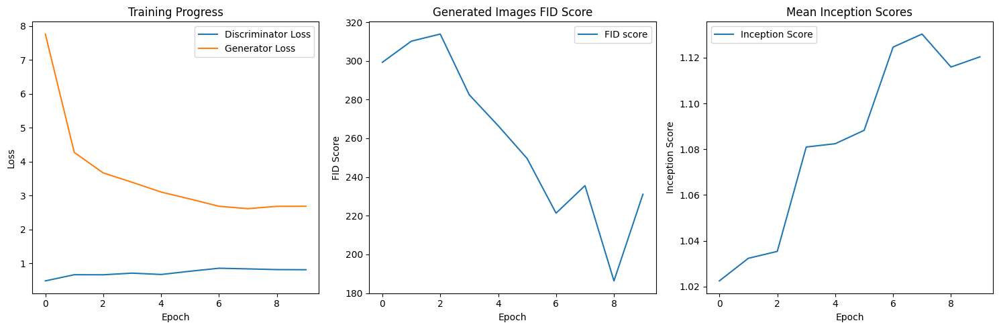

In [19]:
os.makedirs("outputs", exist_ok=True)
plt.figure(figsize=(15,5))
plt.subplot(1,3,1)
plt.plot(dcgan_metrics["Disc Loss"], label="Discriminator Loss")
plt.plot(dcgan_metrics["Gen Loss"], label="Generator Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training Progress")
plt.legend()

plt.subplot(1,3,2)
plt.plot(dcgan_metrics["FID Score"], label="FID score")
plt.xlabel("Epoch")
plt.ylabel("FID Score")
plt.title("Generated Images FID Score")
plt.legend()

plt.subplot(1,3,3)
plt.plot(dcgan_metrics["Mean Inception Score"], label="Inception Score")
plt.xlabel("Epoch")
plt.ylabel("Inception Score")
plt.title("Mean Inception Scores")
plt.legend()
plt.tight_layout()
plt.savefig("outputs/training_curves.png", dpi=150, bbox_inches="tight")
plt.show()


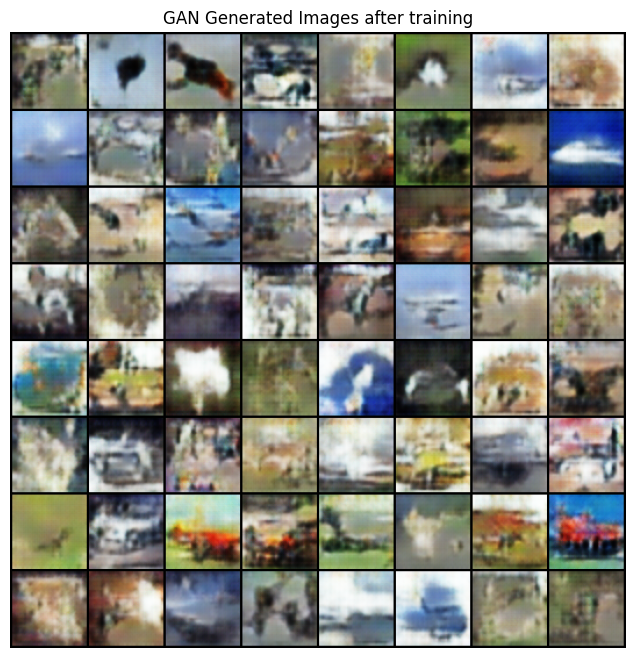

In [25]:
with torch.inference_mode():
  fake_samples = checkpoint_generator(fixed_noise).detach().cpu()
grid = vutils.make_grid(fake_samples[:64], nrow=8, normalize=True)
npimg = grid.permute(1, 2, 0).numpy()
plt.figure(figsize=(8, 8))
plt.imshow(npimg)
plt.title(f"GAN Generated Images after training")
plt.axis("off")
plt.show()



### Diversity Check